In [162]:
import datetime
import sys
import time

from torch.autograd import Variable
from torch.utils.data import DataLoader
import matplotlib.patches as patches
import matplotlib.pyplot as plt
from matplotlib.ticker import NullLocator

In [178]:
from utils.datasets import *
from utils.parse_config import *
from utils.utils import *
from utils.models import *
from evaluate import *
import os

In [179]:
import cv2

os.makedirs('./output_video_imgs', exist_ok=True)
#video = cv2.VideoCapture()

In [180]:

def transform_coordinates(x1,y1,x2,y2):
    w = x2-x1
    h = y2-y1
    return x1,y1,w,h

def show_BBs(img_path, bboxes, output_path = 'output_video_imgs'):
    img = Image.open(img_path)
    img = np.array(img.resize((300, 300)))
    
    img_name = img_path.split('/')[-1]
    fig, axs = plt.subplots()
    axs.imshow(img)
    for bbox in bboxes:
        x1 = float(bbox['x1'])
        y1 = float(bbox['y1'])
        x2 = float(bbox['x2'])
        y2 = float(bbox['y2'])
        x1,y1,w,h = transform_coordinates(x1,y1,x2,y2)
        #print(f'{x1}, {y1}, {w}, {h}')
        bbox = patches.Rectangle((x1,y1),w,h, linewidth=2, edgecolor="r", facecolor="none")
        
        # Add the bbox to the plot
        #plt.add_patch(bbox)
        # Add label
        plt.text(
            x1,
            y1,
            s='Car',
            color="white",
            verticalalignment="top",
            bbox={"color": 'red', "pad": 0},
        )

        plt.axis("off")
        plt.gca().xaxis.set_major_locator(NullLocator())
        plt.gca().yaxis.set_major_locator(NullLocator())
        axs.add_patch(bbox)
    plt.text(
        10,
        15,
        s = img_path.split('/')[-1],
        color = 'black'
    )
    plt.savefig(f'{output_path}/{img_name}', bbox_inches="tight", pad_inches=0.0)



In [181]:
import os
import PIL.Image as Image
import torch
from utils.models import *
from torchvision import transforms
## Read image files and perform object detection on them
## Load Model
model = SSD('./config/ssd-kitti_1.00.cfg', num_classes=7).to('cuda:0')
model.load_state_dict(torch.load('SSD_Original_new.pth_0.100.pth', map_location='cuda:0'))
## Extract first 100 files 
files = [f'{i}.jpg' for i in range(101)]
transform = transforms.Compose([transforms.ToTensor(), transforms.Resize(300)])
img_size = 300
all_bboxes = {}
for i, file in enumerate(files):
    img = Image.open(f'./image_frames/{file}')
    img = transform(img).to('cuda:0')

    ## Add additional batch dimension
    img = img.unsqueeze(0)

    with torch.no_grad():
        detections = model(img, 'eval')
    #print(detections.shape)

    ## Since we are considering all vehicles as cars, 
    ## we force the predicted class to be car in order to apply nms over all predictions 
    detections[:,:,5] = 1
    detections = non_max_suppression(detections, conf_thres=0.8, nms_thres=0.6)[0]
    bboxes = [{'cls': 'Car', 'conf': d[4],'x1': d[0], 'y1': d[1], 'x2': d[2], 'y2':d[3]} for d in detections]
    all_bboxes[file] = bboxes
    #show_BBs(f'./image_frames/{file}', bboxes)

    

[{'cls': 'Car',
  'conf': tensor(0.9981),
  'x1': tensor(24.3026),
  'y1': tensor(83.6850),
  'x2': tensor(80.1108),
  'y2': tensor(133.3590)},
 {'cls': 'Car',
  'conf': tensor(0.9952),
  'x1': tensor(60.8689),
  'y1': tensor(113.4388),
  'x2': tensor(142.1743),
  'y2': tensor(178.0252)},
 {'cls': 'Car',
  'conf': tensor(0.9868),
  'x1': tensor(227.0628),
  'y1': tensor(131.0627),
  'x2': tensor(300.0011),
  'y2': tensor(214.0527)},
 {'cls': 'Car',
  'conf': tensor(0.9613),
  'x1': tensor(52.6721),
  'y1': tensor(105.3020),
  'x2': tensor(125.1034),
  'y2': tensor(162.1227)},
 {'cls': 'Car',
  'conf': tensor(0.9426),
  'x1': tensor(145.7992),
  'y1': tensor(82.3358),
  'x2': tensor(204.0670),
  'y2': tensor(135.5220)}]

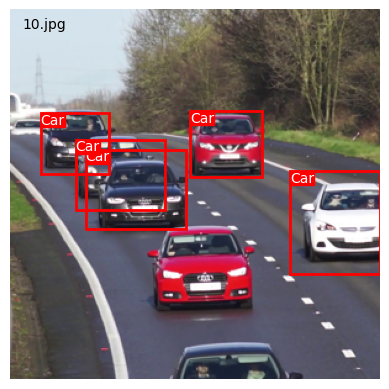

In [182]:

file = '10.jpg'
show_BBs(f'./image_frames/{file}', all_bboxes['10.jpg'])
all_bboxes[file]

In [183]:
## Adding self annotated boxes from json file
import json

with open('2D-on-2D_labeling_save (1).json') as f:
    self_annot_bboxes = json.load(f)

#self_annot_bboxes['annotations']


In [184]:
self_annot_bboxes['imagesLib'][2]['annotations'][0]['position']['x']

191.28308823529412

In [185]:
self_annot_bboxes['imagesLib'][2]['annotations']

[{'classI': 0,
  'position': {'x': 191.28308823529412,
   'y': 348.6507352941176,
   'width': 106.26838235294119,
   'height': 18.992647058823536,
   'stroke': 'red',
   'draggable': True,
   'visible': True,
   'fill': 'rgba(19,28,252,0.05)',
   'name': 'UkR8'}},
 {'classI': 0,
  'position': {'x': 115.76470588235294,
   'y': 221.12867647058823,
   'width': 132.49632352941177,
   'height': 117.12132352941177,
   'stroke': 'red',
   'draggable': True,
   'visible': True,
   'fill': 'rgba(19,28,252,0.05)',
   'name': 'uFcY'}}]

In [186]:
img_size = 369
for img_bbox in self_annot_bboxes['imagesLib']:
    img_name = img_bbox['name']
    for bbox in img_bbox['annotations']:
        x1 = bbox['position']['x']
        y1 = bbox['position']['y']
        width = bbox['position']['width']
        height = bbox['position']['height']

        x2, y2 = x1 + width, y1 + height

        all_bboxes[f'{img_name[:-4]}.jpg'].append({'cls': 'Car', 'conf': 1.00,'x1': x1/img_size * 300, 'y1': y1/img_size * 300, 'x2': x2/img_size * 300, 'y2':y2/img_size * 300})

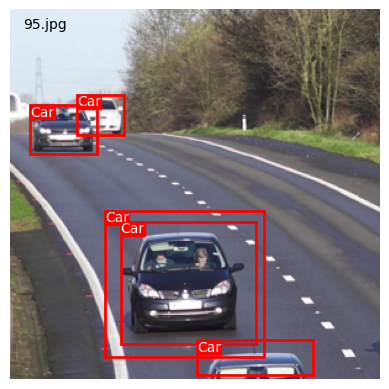

In [187]:
file = '95.jpg'
show_BBs(f'./image_frames/{file}', all_bboxes[file])

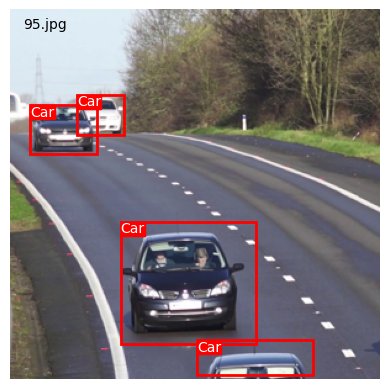

In [188]:
## Additional filtering of bounding boxes required
## Remove bigger bb if smaller bb == intersection
def filter_bbs(bboxes):
    iter_1 = 0
    while(iter_1 < len(bboxes)):
        bbox_1 = bboxes[iter_1]
        iter_2 = iter_1 + 1
        while(iter_2 < len(bboxes)):
            bbox_2 = bboxes[iter_2]
            A_1 = (bbox_1['x2'] - bbox_1['x1']) * (bbox_1['y2'] - bbox_1['y1'])
            A_2 = (bbox_2['x2'] - bbox_2['x1']) * (bbox_2['y2'] - bbox_2['y1'])
            min_A = A_1
            max_box = bbox_2
            if A_1 > A_2: 
                min_A = A_2
                max_box = bbox_1
            
            I = min(bbox_1['x2'], bbox_2['x2']) - max(bbox_1['x1'], bbox_2['x1'])
            I*= min(bbox_1['y2'], bbox_2['y2']) - max(bbox_1['y1'], bbox_2['y1'])

            if abs(I - min_A) < 1e-5: bboxes.remove(max_box)
            else: iter_2+=1
        iter_1 += 1
    return bboxes

filter_bbs(all_bboxes[file])
show_BBs(f'./image_frames/{file}', all_bboxes[file])

In [189]:
## filter rest of the boxes
all_bboxes = {key: filter_bbs(bboxes) for (key, bboxes) in all_bboxes.items()}
 

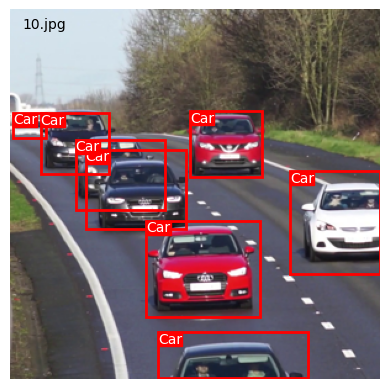

In [190]:
file = '10.jpg'
show_BBs(f'./image_frames/{file}', all_bboxes[file])

/tmp/ipykernel_4421/681391728.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axs = plt.subplots()


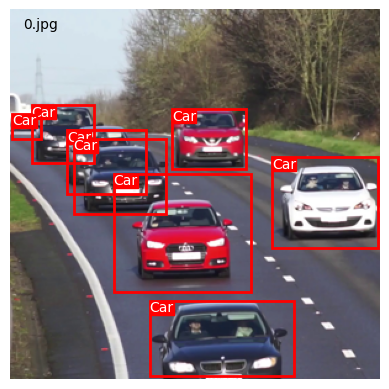

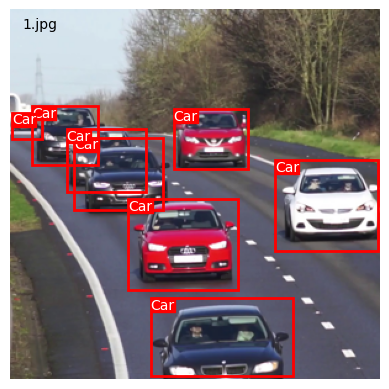

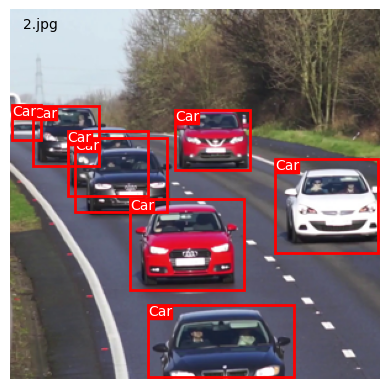

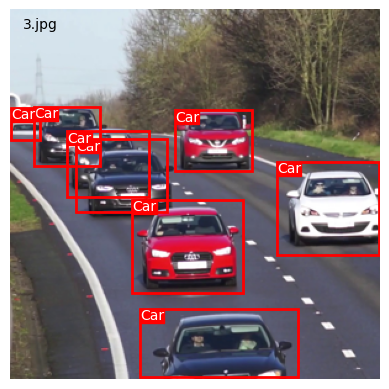

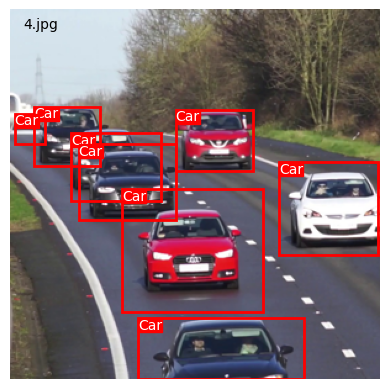

...

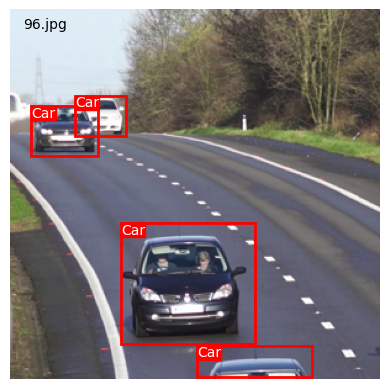

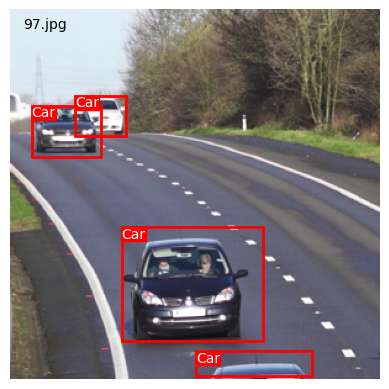

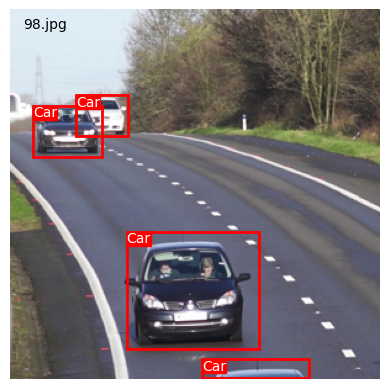

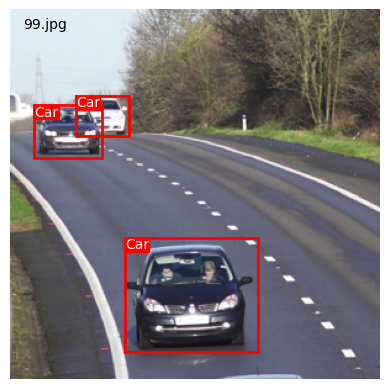

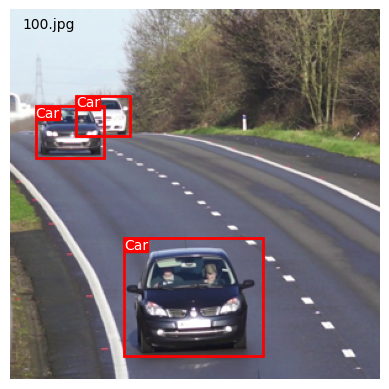

In [191]:
## Printing all frames with their bboxes
files = [f'{i}.jpg' for i in range(101)]

for file in files:
    show_BBs(f'./image_frames/{file}', all_bboxes[file])

In [194]:
## writing bbox label files
for file in files:
    with open(f'./output_video_imgs/{file[:-4]}.txt', 'w') as f:
        for bbox in all_bboxes[file]:
            f.write(f"Car {bbox['conf']:0.2f} {bbox['x1']:0.2f} {bbox['y1']:0.2f} {bbox['x2']:0.2f} {bbox['y2']:0.2f}\n")

    